# Example workflow in dockerHDDM

Author: 

- Wanke Pan (panwanke2023@gmail.com) @Nanjing Normal University
- Hu Chuan-Peng (corresponding author, hcp4715@hotmail.com) @Nanjing Normal University
- Ru-Yuan Zhang (corresponding author, ruyuanzhang@sjtu.edu.cn) @Shanghai Jiao Tong University

This is a supplementary notebook for the introductary paper *A Hitchhiker’s Guide to Bayesian Hierarchical Drift-Diffusion Modeling with dockerHDDM*. 

This notebook was tested in docker image [`hcp4715/hddm:0.9.8-amd64`](https://hub.docker.com/r/hcp4715/hddm/tags), where the packages `kabuki` were rectfied to RC version as below code box.

Preprint of this manuscript: https://psyarxiv.com/6uzga/

Github repository at: https://github.com/hcp4715/dockerHDDM

## Loading modules/packages

In [4]:
%matplotlib inline

# General packages for system, time, etc
import os, time, csv, sys
import datetime
from datetime import date
import glob

# scitnific computing and plotting
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt
import seaborn as sns

# HDDM related packages
import pymc as pm
import hddm
import kabuki
import arviz as az
print("The current HDDM version is: ", hddm.__version__)
print("The current kabuki version is: ", kabuki.__version__)
print("The current PyMC version is: ", pm.__version__)
print("The current ArviZ version is: ", az.__version__)

The current HDDM version is:  0.9.8RC
The current kabuki version is:  0.6.5RC3
The current PyMC version is:  2.3.8
The current ArviZ version is:  0.15.1


## Load the example data Cavanaght et al. (2011)

The data file is included in HDDM, so we directly load it.

In [3]:
data_cavanagh = hddm.load_csv(hddm.__path__[0] + '/examples/cavanagh_theta_nn.csv')
data_cavanagh.tail()

,subj_idx,stim,rt,response,theta,dbs,conf
3983,13,LL,1.450,0.0,-1.237166,0,HC
3984,13,WL,0.711,1.0,-0.377450,0,LC
3985,13,WL,0.784,1.0,-0.694194,0,LC
3986,13,LL,2.350,0.0,-0.546536,0,HC
3987,13,WW,1.250,1.0,0.752388,0,HC


In [4]:
print("The number of trials: ", data_cavanagh.shape[0])
print("The number of variables: ", data_cavanagh.shape[1])
print("The number of participants: ", data_cavanagh.subj_idx.unique().shape[0])

The number of trials:  3988
The number of variables:  7
The number of participants:  14


## Model specification and fitting

We define 5 models as below table (Table 2 in main text) from the simplest DDM to full DDM to regression models. Explanation for these five models can be found in **Section "Data and Example Models"** in the main text. 

| Models | HDDM functions for defining a model (`df` is the data from Cavanagh et al., 2011) | # param |
|-|-|-|  
| m0 | hddm.HDDM(df, include=\['a', 'v', 't'\]) | 48 |
| m1 | hddm.HDDM(df, include=\'a', 'v', 't', **'z', 'sv', 'sz', 'st'**\]) | 67 |
| m2 | hddm.HDDM(df, include=\['a', 'v', 't','z', 'sv', 'st', 'sz'\], **depends\_on={'v': 'conf'}**) | 82 |
| m3 | hddm.**HDDMRegressor**(df, **"v ~ C(conf, Treatment('LC'))", keep\_regressor\_trace=True,** include=\['a', 'v', 't', 'z', 'sv', 'st', 'sz'\]) | 68 |  
| m4 | hddm.HDDMRegressor(df, "v ~ C(conf, Treatment('LC'))", **group\_only\_regressors=False**, keep\_regressor\_trace=True, include=\['a', 'v', 't', 'z', 'sv', 'st', 'sz'\]) | 83 |

In [4]:
df = data_cavanagh.copy()

# M0_0: base model: simplified
m0 = hddm.HDDM(df, include=['a', 'v', 't'])

# M1: base model: full model
m1 = hddm.HDDM(df, include=['a', 'v', 't', 'z', 'sv', 'sz', 'st'])

# M2: treat within-subj as between-subj: full model
m2 = hddm.HDDM(df, include=['a', 'v', 't','z', 'sv', 'st', 'sz'], depends_on={'v': 'conf'})

# M3: regression model (varying intercept)
m3 = hddm.HDDMRegressor(
  df, "v ~ C(conf, Treatment('LC'))", 
  include=['a', 'v', 't', 'z', 'sv', 'st', 'sz'], 
  keep_regressor_trace=True)

# M4: regression model (varying intercept and slope)
m4 = hddm.HDDMRegressor(
  df, "v ~ C(conf, Treatment('LC'))", 
  include=['a', 'v', 't', 'z', 'sv', 'st', 'sz'], 
  group_only_regressors=False, 
  keep_regressor_trace=True)

No model attribute --> setting up standard HDDM
Set model to ddm
No model attribute --> setting up standard HDDM
Set model to full_ddm
No model attribute --> setting up standard HDDM
Set model to full_ddm
No model attribute --> setting up standard HDDM
Set model to full_ddm
No model attribute --> setting up standard HDDM
Set model to full_ddm


Fitting model with new features (parallel sampling and return inferenceData, see [dockerHDDM primer](./dockerHDDM_primer.ipynb) and **Section New features in dockerHDDM**). 

We set up 4 MCMC chains with 10,000 samples with 5,000 burn-ins with parallel fitting process and return inferred data for by the code `model.sample(10000, burn = 5000, return_infdata = True)`.

In [8]:
n_samples = 10000
n_burn = 5000
n_chains = 4

**Note: Fitting all these six model with settings above (10000 samples) takes about 8-9 hours on a PC with Intel® Core™ i7-10700 CPU @ 2.90GHz. Also, the memory of should be large enough, ~ 64 G memory is recommended. Otherwise,  recommend few samples**

In [9]:
%%time
m0_infdata = m0.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m0")

[                  0%                  ] 13 of 10000 complete in 0.5 sec
[                  0%                  ] 30 of 10000 complete in 1.0 sec
[                  0%                  ] 47 of 10000 complete in 1.6 sec
[                  0%                  ] 64 of 10000 complete in 2.1 sec
[                  0%                  ] 82 of 10000 complete in 2.6 sec
[                  1%                  ] 100 of 10000 complete in 3.1 sec
[                  1%                  ] 117 of 10000 complete in 3.6 sec
[                  1%                  ] 134 of 10000 complete in 4.1 sec
[                  1%                  ] 151 of 10000 complete in 4.6 sec
[                  1%                  ] 169 of 10000 complete in 5.2 sec
[                  1%                  ] 186 of 10000 complete in 5.7 sec
[                  2%                  ] 203 of 10000 complete in 6.2 sec
[                  2%                  ] 220 of 10000 complete in 6.7 sec
[                  2%                  ] 23

In [ ]:
%%time
m1_infdata = m1.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m1")

[                  0%                  ] 2 of 10000 complete in 1.7 sec
[                  0%                  ] 3 of 10000 complete in 2.8 sec
[                  0%                  ] 4 of 10000 complete in 3.4 sec
[                  0%                  ] 5 of 10000 complete in 4.2 sec
[                  0%                  ] 7 of 10000 complete in 5.5 sec
[                  0%                  ] 8 of 10000 complete in 6.1 sec
[                  0%                  ] 9 of 10000 complete in 6.9 sec
[                  0%                  ] 10 of 10000 complete in 7.5 sec
[                  0%                  ] 11 of 10000 complete in 8.2 sec
[                  0%                  ] 12 of 10000 complete in 9.0 sec
[                  0%                  ] 13 of 10000 complete in 9.9 sec
[                  0%                  ] 14 of 10000 complete in 10.7 sec
[                  0%                  ] 15 of 10000 complete in 11.4 sec
[                  0%                  ] 16 of 10000 com

In [ ]:
%%time
m2_infdata = m2.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m2")

[-----------------99%----------------- ] 9928 of 10000 complete in 7493.9 sec
[-----------------99%----------------- ] 9929 of 10000 complete in 7494.6 sec
[-----------------99%----------------- ] 9930 of 10000 complete in 7495.2 sec
[-----------------99%----------------- ] 9931 of 10000 complete in 7495.9 sec
[-----------------99%----------------- ] 9932 of 10000 complete in 7496.5 sec
[-----------------99%----------------- ] 9933 of 10000 complete in 7497.3 sec
[-----------------99%----------------- ] 9934 of 10000 complete in 7498.1 sec
[-----------------99%----------------- ] 9935 of 10000 complete in 7498.8 sec
[-----------------99%----------------- ] 9936 of 10000 complete in 7499.5 sec
[-----------------99%----------------- ] 9937 of 10000 complete in 7500.2 sec
[-----------------99%----------------- ] 9938 of 10000 complete in 7500.9 sec
[-----------------99%----------------- ] 9939 of 10000 complete in 7501.8 sec
[-----------------99%----------------- ] 9940 of 10000 complete 

In [ ]:
%%time
m3_infdata = m3.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m3")

[-----------------99%----------------- ] 9902 of 10000 complete in 7464.2 sec
[-----------------99%----------------- ] 9903 of 10000 complete in 7465.1 sec
[-----------------99%----------------- ] 9904 of 10000 complete in 7465.8 sec
[-----------------99%----------------- ] 9905 of 10000 complete in 7466.6 sec
[-----------------99%----------------- ] 9906 of 10000 complete in 7467.3 sec
[-----------------99%----------------- ] 9907 of 10000 complete in 7468.0 sec
[-----------------99%----------------- ] 9908 of 10000 complete in 7468.6 sec
[-----------------99%----------------- ] 9909 of 10000 complete in 7469.5 sec
[-----------------99%----------------- ] 9910 of 10000 complete in 7470.1 sec
[-----------------99%----------------- ] 9911 of 10000 complete in 7470.8 sec
[-----------------99%----------------- ] 9912 of 10000 complete in 7471.4 sec
[-----------------99%----------------- ] 9913 of 10000 complete in 7472.1 sec
[-----------------99%----------------- ] 9914 of 10000 complete 

In [10]:
%%time
m4_infdata = m4.sample(n_samples, burn = n_burn, chains = n_chains, return_infdata = True, save_name = "model_fitted/m4")

[-----------------93%---------------   ] 9307 of 10000 complete in 333.1 sec
[-----------------93%---------------   ] 9321 of 10000 complete in 333.7 sec
[-----------------93%---------------   ] 9335 of 10000 complete in 334.2 sec
[-----------------93%---------------   ] 9349 of 10000 complete in 334.7 sec
[-----------------93%---------------   ] 9363 of 10000 complete in 335.2 sec
[-----------------93%---------------   ] 9377 of 10000 complete in 335.8 sec
[-----------------93%---------------   ] 9391 of 10000 complete in 336.3 sec
[-----------------94%---------------   ] 9405 of 10000 complete in 336.8 sec
[-----------------94%---------------   ] 9419 of 10000 complete in 337.4 sec
[-----------------94%---------------   ] 9433 of 10000 complete in 337.9 sec
[-----------------94%---------------   ] 9447 of 10000 complete in 338.4 sec
[-----------------94%---------------   ] 9461 of 10000 complete in 338.9 sec
[-----------------94%----------------  ] 9475 of 10000 complete in 339.5 sec

## Model diagnosis

We use `az.plot_trace()` to visually check the trace plot of MCMC chains and use `az.summary()` to check $\hat{R}$ and Effective Sample Size (ESS). 

### Diagnosis of Model 0

#### Trace plot

We can also only plot selected parameters' traces. 
 
- use regex to select var_names that start with "a" and do not contain either "subj" or "std".

/opt/conda/lib/python3.8/site-packages/arviz/plots/traceplot.py:217: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (48), generating only 20 plots
  warnings.warn(


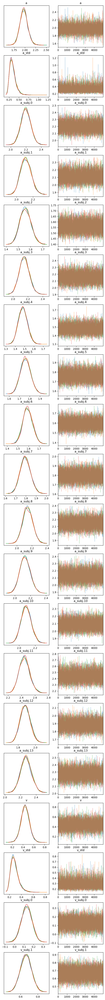

In [5]:
tmp_infdata = m0_infdata
plt.rc('font', size=16)

# plot traces for all parameters
axes = az.plot_trace(tmp_infdata, compact = False, figsize = [7, 70])

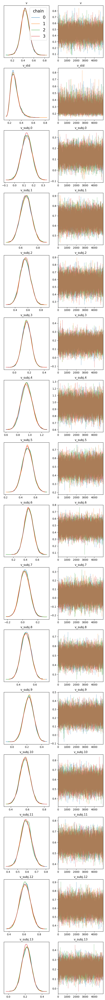

In [6]:
# select parameter v as a example
axes = az.plot_trace(
    tmp_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 70]
)

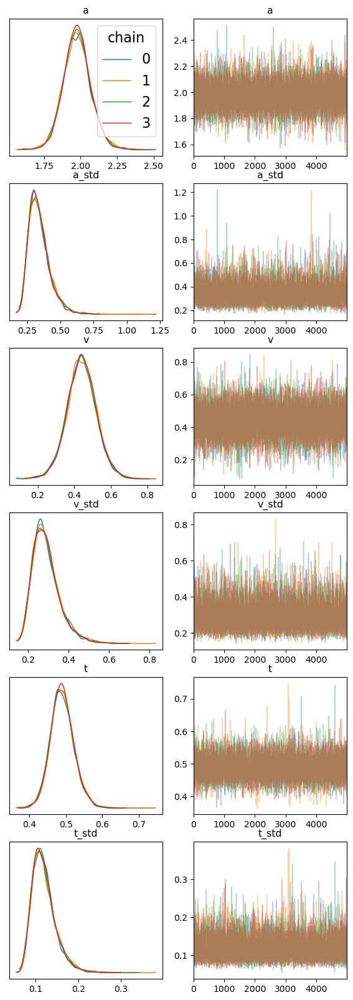

In [7]:
# select group level parameters
axes = az.plot_trace(
    tmp_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 20]
)

#### $\hat{R}$ and ESS

In [8]:
summary_tmp = az.summary(tmp_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
t_subj.10,0.0002,0.0001,10263.7148,11258.2805,1.0010
a,0.0008,0.0005,16348.7392,12699.7193,1.0007
a_subj.12,0.0006,0.0004,10134.8625,12367.9579,1.0006
t_subj.12,0.0001,0.0001,9953.8772,12548.6384,1.0006
t_subj.6,0.0001,0.0001,10337.4748,12443.6106,1.0005
t_std,0.0003,0.0002,11035.6357,10237.6846,1.0005
v_subj.4,0.0008,0.0006,14017.6269,13950.0491,1.0005
v_subj.1,0.0005,0.0003,17134.8680,15125.0490,1.0005
t_subj.13,0.0003,0.0002,9145.6695,11692.1095,1.0005
a_subj.3,0.0007,0.0005,9916.1247,12245.5738,1.0005


In [9]:
# only calculate R hat
az.rhat(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:    ()
Data variables: (12/48)
    a          float64 1.001
    a_std      float64 1.0
    a_subj.0   float64 1.0
    a_subj.1   float64 1.0
    a_subj.2   float64 1.0
    a_subj.3   float64 1.001
    ...         ...
    t_subj.8   float64 1.0
    t_subj.9   float64 1.0
    t_subj.10  float64 1.001
    t_subj.11  float64 1.0
    t_subj.12  float64 1.001
    t_subj.13  float64 1.001>

In [10]:
# only calculate ESS
az.ess(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:    ()
Data variables: (12/48)
    a          float64 1.635e+04
    a_std      float64 9.754e+03
    a_subj.0   float64 1.032e+04
    a_subj.1   float64 9.35e+03
    a_subj.2   float64 9.945e+03
    a_subj.3   float64 9.916e+03
    ...         ...
    t_subj.8   float64 9.666e+03
    t_subj.9   float64 1.182e+04
    t_subj.10  float64 1.026e+04
    t_subj.11  float64 9.172e+03
    t_subj.12  float64 9.954e+03
    t_subj.13  float64 9.146e+03>

### Diagnosis of Model 1

#### Trace plot

/opt/conda/lib/python3.8/site-packages/arviz/plots/traceplot.py:217: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (67), generating only 20 plots
  warnings.warn(


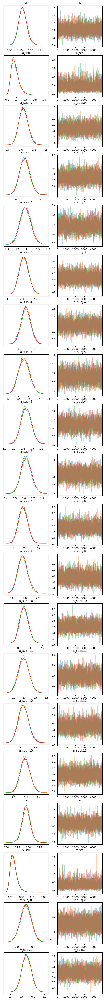

In [19]:
tmp_infdata = m1_infdata

# plot traces for all parameters
axes = az.plot_trace(tmp_infdata, compact = False, figsize = [7, 70])

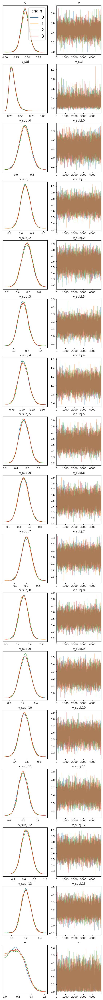

In [20]:
# select parameter v as a example
axes = az.plot_trace(
    tmp_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 70]
)

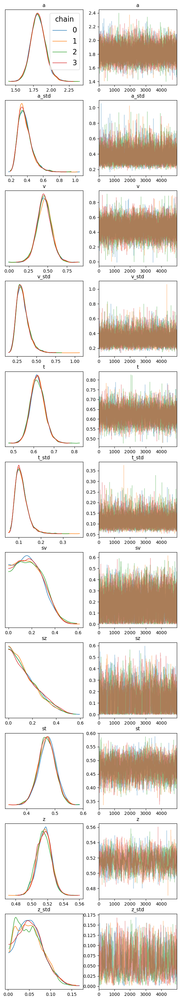

In [21]:
# select group level parameters
axes = az.plot_trace(
    tmp_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 40]
)

#### $\hat{R}$ and ESS

In [22]:
summary_tmp = az.summary(tmp_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_std,0.0013,0.0009,442.3631,482.8020,1.0046
z_subj.10,0.0006,0.0004,815.7914,1713.1271,1.0030
st,0.0007,0.0005,1704.9332,3775.1049,1.0026
z_subj.8,0.0004,0.0003,1420.2922,4706.3782,1.0023
z,0.0003,0.0002,815.1939,2303.4789,1.0022
z_subj.12,0.0004,0.0003,1433.4677,4436.9576,1.0022
z_subj.2,0.0004,0.0003,1578.8248,4819.3364,1.0017
z_subj.4,0.0004,0.0003,1831.6595,3511.0617,1.0017
t_subj.4,0.0005,0.0004,2294.7734,3859.0153,1.0013
z_subj.3,0.0003,0.0002,1863.4034,5402.8260,1.0013


In [23]:
# only calculate R hat
az.rhat(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:    ()
Data variables: (12/67)
    a          float64 1.0
    a_std      float64 1.0
    a_subj.0   float64 1.001
    a_subj.1   float64 1.001
    a_subj.2   float64 1.001
    a_subj.3   float64 1.0
    ...         ...
    z_subj.8   float64 1.002
    z_subj.9   float64 1.001
    z_subj.10  float64 1.003
    z_subj.11  float64 1.001
    z_subj.12  float64 1.002
    z_subj.13  float64 1.001>

In [24]:
# only calculate ESS
az.ess(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:    ()
Data variables: (12/67)
    a          float64 1.126e+04
    a_std      float64 9.791e+03
    a_subj.0   float64 6.26e+03
    a_subj.1   float64 5.178e+03
    a_subj.2   float64 4.923e+03
    a_subj.3   float64 7.086e+03
    ...         ...
    z_subj.8   float64 1.42e+03
    z_subj.9   float64 1.341e+03
    z_subj.10  float64 815.8
    z_subj.11  float64 1.733e+03
    z_subj.12  float64 1.433e+03
    z_subj.13  float64 1.844e+03>

### Diagnosis of Model 2

#### Trace plot

/opt/conda/lib/python3.8/site-packages/arviz/plots/traceplot.py:217: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (82), generating only 20 plots
  warnings.warn(


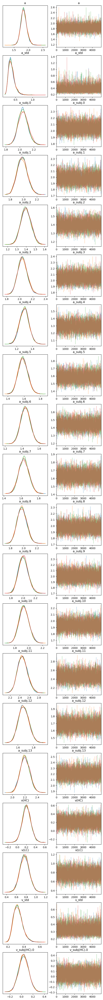

In [25]:
tmp_infdata = m2_infdata

# plot traces for all parameters
axes = az.plot_trace(tmp_infdata, compact = False, figsize = [7, 70])

/opt/conda/lib/python3.8/site-packages/arviz/plots/traceplot.py:217: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (32), generating only 20 plots
  warnings.warn(


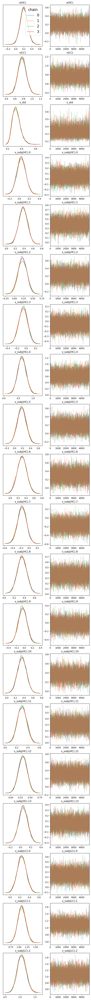

In [26]:
# select parameter v as a example
axes = az.plot_trace(
    tmp_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 80]
)

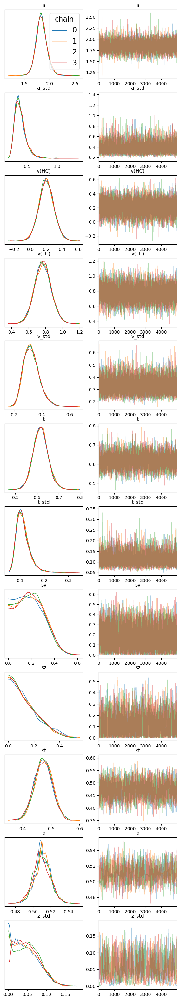

In [27]:
# select group level parameters
axes = az.plot_trace(
    tmp_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 40]
)

#### $\hat{R}$ and ESS

In [28]:
summary_tmp = az.summary(tmp_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_std,0.0017,0.0012,271.0430,223.4598,1.0176
z_subj.10,0.0008,0.0006,544.3208,1074.6984,1.0072
z_subj.13,0.0003,0.0002,1829.4385,4774.3722,1.0061
z_subj.3,0.0003,0.0002,1662.9507,4666.1177,1.0047
z_subj.5,0.0005,0.0003,1174.2099,3017.1537,1.0043
z,0.0003,0.0002,721.8333,1583.1038,1.0043
z_subj.7,0.0003,0.0002,1630.4751,4686.3406,1.0042
z_subj.6,0.0004,0.0003,1335.9230,3281.0577,1.0040
z_subj.2,0.0004,0.0003,1195.9955,3859.4548,1.0037
z_subj.9,0.0004,0.0003,1233.7571,3108.0881,1.0036


In [29]:
# only calculate R hat
az.rhat(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:        ()
Data variables: (12/82)
    a              float64 1.0
    a_std          float64 1.0
    a_subj.0       float64 1.001
    a_subj.1       float64 1.001
    a_subj.2       float64 1.001
    a_subj.3       float64 1.001
    ...             ...
    z_subj.8       float64 1.002
    z_subj.9       float64 1.004
    z_subj.10      float64 1.007
    z_subj.11      float64 1.003
    z_subj.12      float64 1.004
    z_subj.13      float64 1.006>

In [30]:
# only calculate ESS
az.ess(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:        ()
Data variables: (12/82)
    a              float64 1.024e+04
    a_std          float64 8.858e+03
    a_subj.0       float64 5.53e+03
    a_subj.1       float64 4.927e+03
    a_subj.2       float64 4.252e+03
    a_subj.3       float64 6.336e+03
    ...             ...
    z_subj.8       float64 1.071e+03
    z_subj.9       float64 1.234e+03
    z_subj.10      float64 544.3
    z_subj.11      float64 1.654e+03
    z_subj.12      float64 1.199e+03
    z_subj.13      float64 1.829e+03>

### Diagnosis of Model 3

#### Trace plot

/opt/conda/lib/python3.8/site-packages/arviz/plots/traceplot.py:217: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (68), generating only 20 plots
  warnings.warn(


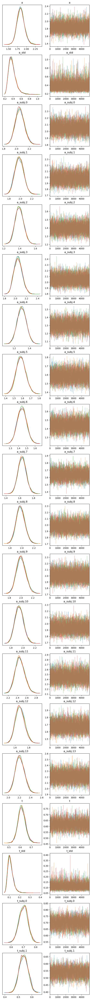

In [31]:
tmp_infdata = m3_infdata

# plot traces for all parameters
axes = az.plot_trace(tmp_infdata, compact = False, figsize = [7, 80])

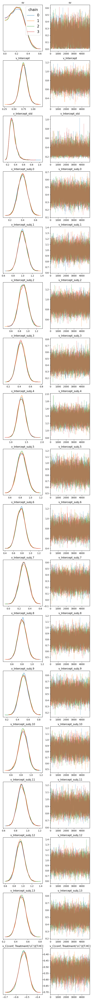

In [32]:
# select parameter v as a example
axes = az.plot_trace(
    tmp_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 80]
)

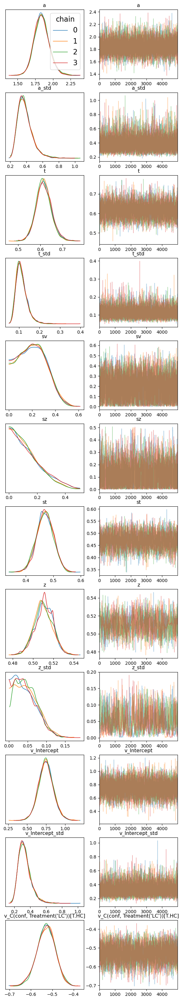

In [33]:
# select group level parameters
axes = az.plot_trace(
    tmp_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 40]
)

#### $\hat{R}$ and ESS

In [34]:
summary_tmp = az.summary(tmp_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_std,0.0015,0.0011,315.9937,235.1380,1.0051
z_subj.5,0.0005,0.0004,878.6864,3771.0987,1.0034
z_subj.9,0.0005,0.0004,903.2011,3739.5268,1.0031
z_subj.6,0.0004,0.0003,1097.4792,4279.7746,1.0029
st,0.0007,0.0005,2030.2414,4492.0076,1.0029
z_subj.4,0.0004,0.0003,1389.7953,3927.3415,1.0027
z_subj.10,0.0007,0.0005,626.2461,1280.6674,1.0026
t_subj.8,0.0007,0.0005,2238.0279,4496.2324,1.0025
t_subj.5,0.0005,0.0003,2665.2755,6092.4790,1.0025
z_subj.7,0.0003,0.0002,1416.4778,4820.8882,1.0024


In [35]:
# only calculate R hat
az.rhat(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:                           ()
Data variables: (12/68)
    a                                 float64 1.0
    a_std                             float64 1.0
    a_subj.0                          float64 1.001
    a_subj.1                          float64 1.0
    a_subj.2                          float64 1.001
    a_subj.3                          float64 1.0
    ...                                ...
    v_Intercept_subj.9                float64 1.001
    v_Intercept_subj.10               float64 1.001
    v_Intercept_subj.11               float64 1.0
    v_Intercept_subj.12               float64 1.0
    v_Intercept_subj.13               float64 1.0
    v_C(conf, Treatment('LC'))[T.HC]  float64 1.001>

In [36]:
# only calculate ESS
az.ess(tmp_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:                           ()
Data variables: (12/68)
    a                                 float64 1.142e+04
    a_std                             float64 9.465e+03
    a_subj.0                          float64 6.16e+03
    a_subj.1                          float64 5.132e+03
    a_subj.2                          float64 4.724e+03
    a_subj.3                          float64 6.492e+03
    ...                                ...
    v_Intercept_subj.9                float64 3.84e+03
    v_Intercept_subj.10               float64 2.367e+03
    v_Intercept_subj.11               float64 3.128e+03
    v_Intercept_subj.12               float64 4.975e+03
    v_Intercept_subj.13               float64 4.355e+03
    v_C(conf, Treatment('LC'))[T.HC]  float64 2.9e+03>

### Diagnosis of Model 4

#### Trace plot

/opt/conda/lib/python3.8/site-packages/arviz/plots/traceplot.py:217: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (83), generating only 20 plots
  warnings.warn(


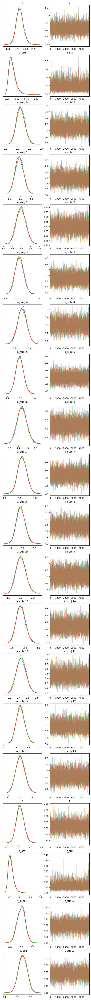

In [37]:
# plot traces for all parameters
axes = az.plot_trace(m4_infdata, compact = False, figsize = [7, 80])

/opt/conda/lib/python3.8/site-packages/arviz/plots/traceplot.py:217: UserWarning: rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (33), generating only 20 plots
  warnings.warn(


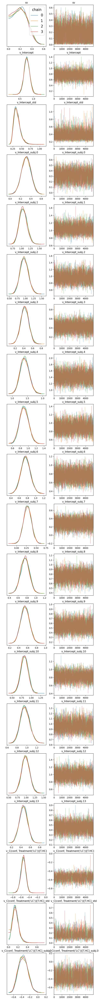

In [38]:
# select parameter v as a example
axes = az.plot_trace(
    m4_infdata, 
    var_names= ('v'), 
    filter_vars="like", 
    compact = False, 
    legend=True, 
    figsize = [7, 80]
)

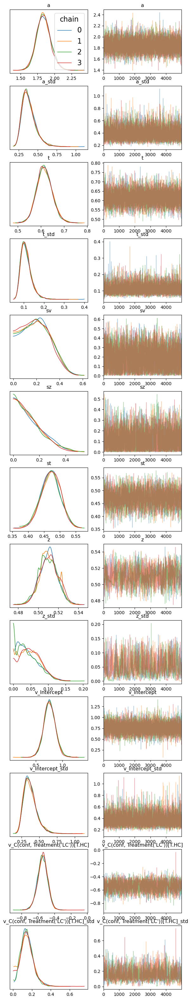

In [39]:
# select group level parameters
axes = az.plot_trace(
    m4_infdata, 
    var_names=['~subj'], 
    filter_vars='regex',
    compact = False, 
    legend=True, 
    figsize = [7, 40]
)

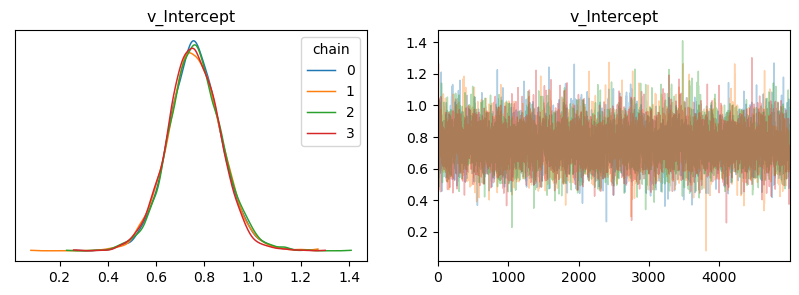

In [ ]:
# plot example for main text
axes = az.plot_trace(m4_infdata, var_names=["v_Intercept"], compact = False, legend=True, figsize = [10, 3])

In [ ]:
axes.ravel()[0].figure.savefig("fig6a.pdf")

#### $\hat{R}$ and ESS

In [40]:
summary_tmp = az.summary(m4_infdata, kind = "diagnostics", round_to=4)
summary_tmp.sort_values('r_hat', ascending=False).head(10)

,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
z_subj.10,0.0007,0.0005,559.6614,1508.8663,1.0137
z_std,0.0017,0.0012,231.4752,162.3132,1.0118
z_subj.9,0.0005,0.0004,720.1698,1515.1079,1.0088
z_subj.5,0.0005,0.0004,690.6138,1399.5685,1.0082
z_subj.6,0.0005,0.0004,800.6655,2042.2894,1.0081
z,0.0004,0.0003,507.1598,1668.9164,1.0050
z_subj.8,0.0004,0.0003,931.8502,3861.8206,1.0050
z_subj.12,0.0004,0.0003,973.4637,4366.5704,1.0050
z_subj.1,0.0005,0.0003,936.9064,4326.4901,1.0043
v_Intercept_subj.10,0.0019,0.0014,2738.3745,6198.5123,1.0042


In [41]:
# only calculate R hat
az.rhat(m4_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:                                   ()
Data variables: (12/83)
    a                                         float64 1.001
    a_std                                     float64 1.001
    a_subj.0                                  float64 1.001
    a_subj.1                                  float64 1.001
    a_subj.2                                  float64 1.001
    a_subj.3                                  float64 1.001
    ...                                        ...
    v_C(conf, Treatment('LC'))[T.HC]_subj.8   float64 1.001
    v_C(conf, Treatment('LC'))[T.HC]_subj.9   float64 1.001
    v_C(conf, Treatment('LC'))[T.HC]_subj.10  float64 1.001
    v_C(conf, Treatment('LC'))[T.HC]_subj.11  float64 1.002
    v_C(conf, Treatment('LC'))[T.HC]_subj.12  float64 1.001
    v_C(conf, Treatment('LC'))[T.HC]_subj.13  float64 1.001>

In [42]:
# only calculate ESS
az.ess(m4_infdata).values

<bound method Mapping.values of <xarray.Dataset>
Dimensions:                                   ()
Data variables: (12/83)
    a                                         float64 1.019e+04
    a_std                                     float64 9.283e+03
    a_subj.0                                  float64 5.639e+03
    a_subj.1                                  float64 4.062e+03
    a_subj.2                                  float64 5.104e+03
    a_subj.3                                  float64 6.098e+03
    ...                                        ...
    v_C(conf, Treatment('LC'))[T.HC]_subj.8   float64 2.628e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.9   float64 3.975e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.10  float64 5.262e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.11  float64 2.08e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.12  float64 3.048e+03
    v_C(conf, Treatment('LC'))[T.HC]_subj.13  float64 2.921e+03>

Since `z_subj.10` and `z_std` both have $\hat{R}$ > 1.01 and `z_std` have ESS bulk < 400, we double-check these two parameters with a trace plot.

- In terms of the posterior distribution, 'z_subj.10' and 'z_std' differ in the consistency of convergence of the four chains and their hdi (highest density interval).
- Since the 'z_std' obeys the truncate distribution, its mean and mode are clustered around 0
- However, from the trace plot, it is clear that 'z_std' has non-converge feature in chain 2 (the long regions of monotonicity like a line parallel to the x-axis).
    - (see 2.4 Diagnosing Numerical Inference in Martin, O.A., et. cl (2021) Bayseian Modeling and Computation in Python).

However, in general, the $\hat{R}$ of the two parameters is close to 1.01, and more broadly speaking, less than 1.1. And the distribution of the chains is still stable and consistent, we think this result is acceptable.

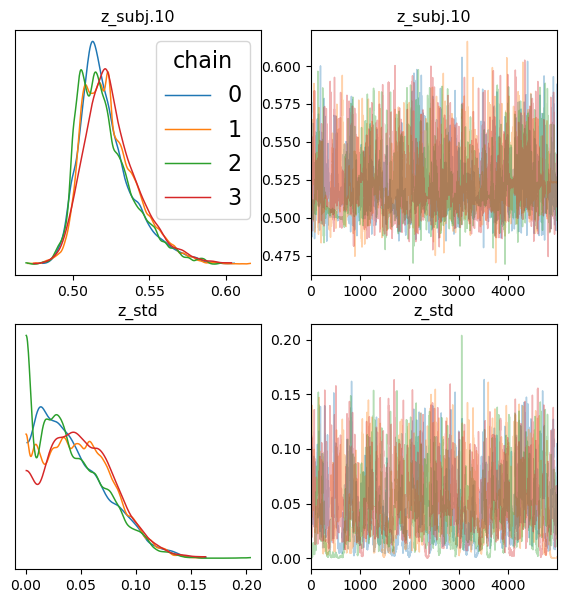

In [46]:
# select `z_subj.10` and `z_std`
axes = az.plot_trace(
    m4_infdata, 
    var_names=['z_subj.10', 'z_std'], 
    compact = False, 
    legend=True, 
    figsize = [7, 7]
)

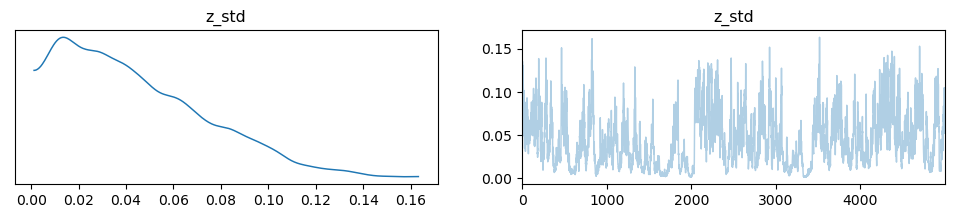

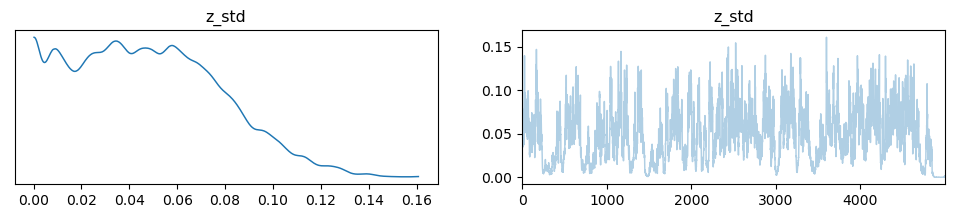

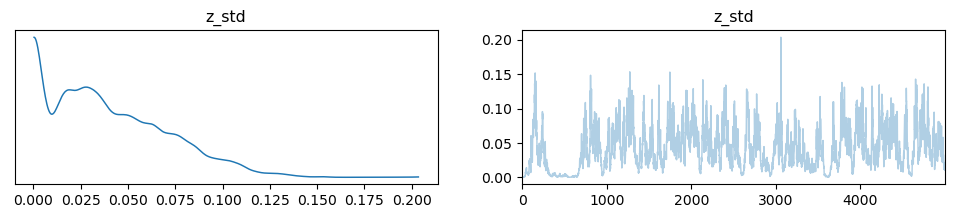

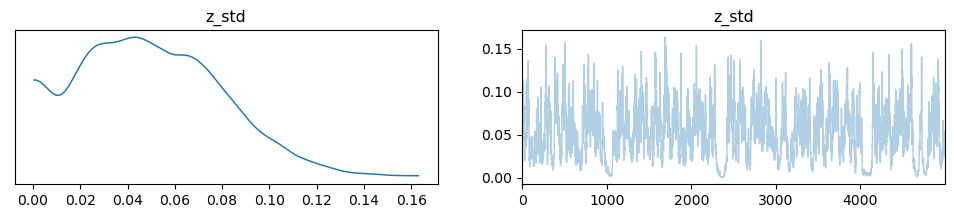

In [74]:
for i in range(4):
    
    az.plot_trace(
        m4_infdata, 
        var_names=['z_std'], 
        coords = {'chain': [i]}, 
        compact = False, 
        combined = False
    )

## Model comparison and selection

### DIC

Here we record the DIC of each model in the models and sort by DIC.

In [9]:
dic_dict = {
  "m0":m0.dic,
  "m1":m1.dic,
  "m2":m2.dic,
  "m3":m3.dic,
  "m4":m4.dic
}

comp_dic = pd.DataFrame.from_dict(dic_dict, orient='index', columns=['DIC'])
comp_dic['model'] = comp_dic.index
comp_dic = comp_dic[['model', 'DIC']]
comp_dic.sort_values(by=['DIC'], ascending = True)

,model,DIC
m4,m4,10654.885215
m2,m2,10655.238644
m3,m3,10660.742603
m1,m1,10835.238849
m0,m0,10973.146002


### PSIS-LOO-CV

Take few hours to calculate the pointwise log-likelihood. 

In [4]:
%%time
m0_infdata = m0.to_infdata(loglike = True, save_name = "model_fitted/m0")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood:  58.659 s
Start converting to InferenceData...
CPU times: user 1min 36s, sys: 8.92 s, total: 1min 45s
Wall time: 1min 57s


In [5]:
%%time
m1_infdata = m1.to_infdata(loglike = True, save_name = "model_fitted/m1")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood:  95.153 s
Start converting to InferenceData...
CPU times: user 1min 34s, sys: 8.59 s, total: 1min 43s
Wall time: 2min 35s


In [6]:
%%time
m2_infdata = m2.to_infdata(loglike = True, save_name = "model_fitted/m2")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood:  106.334 s
Start converting to InferenceData...
CPU times: user 1min 40s, sys: 8.09 s, total: 1min 48s
Wall time: 2min 46s


In [7]:
%%time
m3_infdata = m3.to_infdata(loglike = True, save_name = "model_fitted/m3")

Start to calculate pointwise log likelihood...
The time of calculation of loglikelihood:  1402.38 s
Start converting to InferenceData...
CPU times: user 1min 44s, sys: 10.8 s, total: 1min 55s
Wall time: 24min 28s


In [ ]:
%%time
m4_infdata = m4.to_infdata(loglike = True, save_name = "model_fitted/m4")

Start to calculate pointwise log likelihood...


Warining here is caused by large number as input of `exp()`, solution is [here](https://stackoverflow.com/questions/40726490/overflow-error-in-pythons-numpy-exp-function).

In [ ]:
compare_dict = {
  "m0":m0_infdata,
  "m1":m1_infdata,
  "m2":m2_infdata,
  "m3":m3_infdata,
  "m4":m4_infdata
}

In [38]:
comp_loo = az.compare(compare_dict, ic='loo', scale="deviance")
comp_loo

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1048: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1080: RuntimeWarning: overflow encountered in expm1
  x = np.expm1(-kappa * np.log1p(-probs)) / kappa
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1048: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1080: RuntimeWarning: overflow encountered in expm1
  x = np.expm1(-kappa * np.log1p(-probs)) / kappa
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1048: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1080: RuntimeWarning: overflow encountered in expm1
  x = np.expm1(-kappa * np.log1p(

,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
ms4,0,16989.845983,3090.371443,0.000000,3.891242e-01,2684.316972,0.000000,True,deviance
ms3,1,17092.294429,3131.972847,102.448445,1.283791e-01,2651.010887,164.096298,True,deviance
ms2,2,17558.232174,3380.092525,568.386190,2.889683e-01,2846.888490,334.517479,True,deviance
ms1,3,17821.830305,3410.453022,831.984322,2.371228e-12,2805.408035,311.456248,True,deviance
ms0,4,29258.028358,9112.555312,12268.182375,1.935283e-01,4500.111226,4965.890252,True,deviance


####  WAIC

In [39]:
comp_waic = az.compare(compare_dict, ic='waic', scale="deviance")
comp_waic

,rank,waic,p_waic,d_waic,weight,se,dse,warning,waic_scale
ms3,0,23698.038738,6434.845002,0.000000,0.000000,6828.107498,0.000000,True,deviance
ms4,1,24450.049571,6820.473236,752.010833,0.592812,7313.751016,534.825258,True,deviance
ms2,2,25051.495310,7126.724093,1353.456572,0.204882,7281.221385,704.296319,True,deviance
ms1,3,25470.677727,7234.876733,1772.638989,0.000000,7256.164389,763.623469,True,deviance
ms0,4,77959.448495,33463.265380,54261.409757,0.202306,24418.323919,25233.449382,True,deviance


### PSIS issues
**Warnings**: Now that we found $\hat{k} >  0.7$, which means importance sampling (PSIS) is not able to provide useful estimate for that component/observation. Highly influential observations have high $\hat{k}$ values. Very high $\hat{k}$ values often indicate model misspecification, outliers or mistakes in data processing.

Also, `p_loo`is large than *p*, which is number of parameters of the model. Large `p_loo` means the model is badly misspecified according to Aki Vehtari's [Q & A](https://avehtari.github.io/modelselection/CV-FAQ.html#18_What_is_the_interpretation_of_p_loo). For all models, the *N*, number of obersvations, is 3988, and the number of parameters varies from 48 to 83. Thus, `p_loo` is much larger than numbers of parameters for all models.

As we can from below, this was primarily because of a few outliers. As HDDM allow for 5 percent of outliers in modelling, it is not surprising that these outliers stronly influenced the model performance. Here, we remove the outliers from all models and check the results again.

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1069: RuntimeWarning: overflow encountered in expm1
  x = np.expm1(-kappa * np.log1p(-probs)) / kappa
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1069: RuntimeWarning: overflow encountered in expm1
  x = np.expm1(-kappa * np.log1p(-probs)) / kappa


CPU times: user 1min 11s, sys: 3.93 s, total: 1min 15s
Wall time: 1min 15s


<AxesSubplot: title={'center': 'm3 - m4'}, ylabel='ELPD difference'>

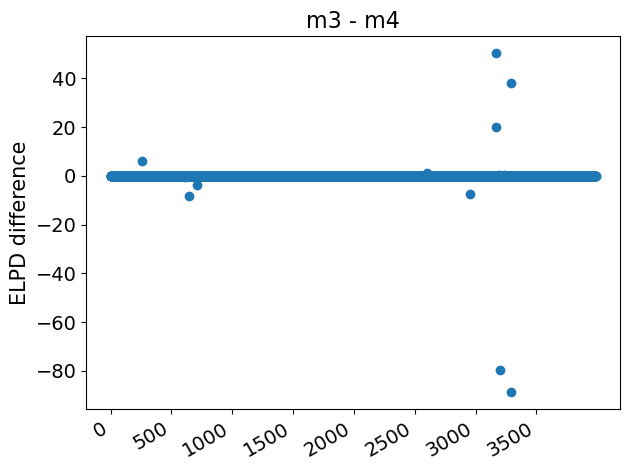

In [11]:
%%time
az.plot_elpd({"m3": m3_infdata, "m4": m4_infdata}, xlabels=True)

Below we visulaize the `k_hat` of each data point.

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1069: RuntimeWarning: overflow encountered in expm1
  x = np.expm1(-kappa * np.log1p(-probs)) / kappa


CPU times: user 35.3 s, sys: 1.58 s, total: 36.9 s
Wall time: 36.9 s


<AxesSubplot: xlabel='Data Point', ylabel='Shape parameter k'>

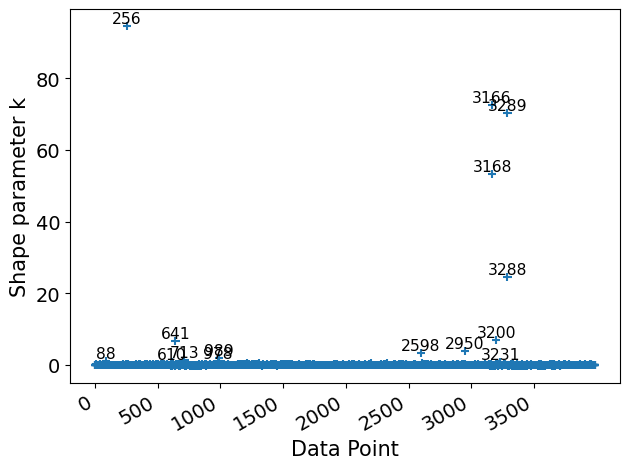

In [12]:
%%time
khats = az.loo(m4_infdata, pointwise=True).pareto_k

az.plot_khat(khats, xlabels=True, threshold=0.7)

Here we used a very simple soluation: removing the outliers and re-calculate the `loo` and `waic`.

In [5]:
%%time
loo_m0 = az.loo(m0_infdata, pointwise=True)
loo_m1 = az.loo(m1_infdata, pointwise=True)
loo_m2 = az.loo(m2_infdata, pointwise=True)
loo_m3 = az.loo(m3_infdata, pointwise=True)
loo_m4 = az.loo(m4_infdata, pointwise=True)

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1035: RuntimeWarning: invalid value encountered in multiply
  k_ary = np.log1p(-b_ary[:, None] * ary).mean(axis=1)  # pylint: disable=no-member
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1052: RuntimeWarning: invalid value encountered in double_scalars
  sigma = -k_post / b_post
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1037: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)
/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:803: UserWarning: Estimated shape parameter of Pareto distribution is greater than 0.7 for one or more samples. You should consider using a more robust model, this is because importance sampling is less likely to work well if the marginal posterior and LOO posterior are very different. This is more likely to happen with a non-robust model and highly influential observations.
  warnings.warn(
/opt/conda/

CPU times: user 2min 57s, sys: 11.5 s, total: 3min 9s
Wall time: 3min 10s


In [6]:
outliers0 = loo_m0.pareto_k.where(loo_m0.pareto_k >= 0.7, drop= True).obs_id.values
outliers1 = loo_m1.pareto_k.where(loo_m1.pareto_k >= 0.7, drop= True).obs_id.values
outliers2 = loo_m2.pareto_k.where(loo_m2.pareto_k >= 0.7, drop= True).obs_id.values
outliers3 = loo_m3.pareto_k.where(loo_m3.pareto_k >= 0.7, drop= True).obs_id.values
outliers4 = loo_m4.pareto_k.where(loo_m4.pareto_k >= 0.7, drop= True).obs_id.values

# create a index array to remove outliers
outliers = np.unique(np.concatenate((outliers0, outliers1, outliers2, outliers3, outliers4), axis=0))
new_indx = data_cavanagh.index.values[~np.isin(data_cavanagh.index.values, outliers)]

In [5]:
%%time
m0_infdata = m0_infdata.isel(obs_id=new_indx)
m1_infdata = m1_infdata.isel(obs_id=new_indx)
m2_infdata = m2_infdata.isel(obs_id=new_indx)
m3_infdata = m3_infdata.isel(obs_id=new_indx)
m4_infdata = m4_infdata.isel(obs_id=new_indx)

CPU times: user 24.2 ms, sys: 25 µs, total: 24.3 ms
Wall time: 24.1 ms


In [ ]:
compare_dict2 = {
  "m0":m0_infdata,
  "m1":m1_infdata,
  "m2":m2_infdata,
  "m3":m3_infdata,
  "m4":m4_infdata
}

In [46]:
comp_loo2 = az.compare(compare_dict2, ic='loo', scale="deviance")
comp_loo2

/opt/conda/lib/python3.8/site-packages/arviz/stats/stats.py:1048: RuntimeWarning: overflow encountered in exp
  weights = 1 / np.exp(len_scale - len_scale[:, None]).sum(axis=1)


,rank,loo,p_loo,d_loo,weight,se,dse,warning,loo_scale
ms4,0,10646.246430,50.725559,0.000000,9.147305e-13,123.509673,0.000000,False,deviance
ms2,1,10647.206470,55.943728,0.960040,5.660574e-01,123.340999,5.882238,False,deviance
ms3,2,10650.379132,43.231669,4.132702,2.282562e-01,123.394241,4.851643,False,deviance
ms1,3,10824.930559,41.744451,178.684130,4.426213e-12,120.527026,28.139917,False,deviance
ms0,4,10884.000088,36.239047,237.753658,2.056864e-01,117.516809,40.422374,False,deviance


In [47]:
comp_waic2 = az.compare(compare_dict2, ic='waic', scale="deviance")
comp_waic2

,rank,waic,p_waic,d_waic,weight,se,dse,warning,waic_scale
ms4,0,10646.198225,50.701457,0.000000,0.000000,123.508432,0.000000,False,deviance
ms2,1,10647.152619,55.916803,0.954393,0.566269,123.339607,5.882308,False,deviance
ms3,2,10650.339862,43.212034,4.141637,0.227521,123.393387,4.851192,False,deviance
ms1,3,10824.891214,41.724779,178.692989,0.000000,120.526164,28.139530,False,deviance
ms0,4,10883.438891,35.958449,237.240665,0.206210,117.506792,40.416072,True,deviance


warning: using `az.loo_pit` requires same shape for  y_hat and log_weights, which is not the case if the PPC samples is not the same as the sample of MCMC.

In [48]:
# az.loo_pit(idata=InfData['m0'], y="rt") 

## Posterior predictive check

First, let's spend some time generating posterior predictions. Note that we set `n_ppc` is 500 means we generate 500 samples for each draws in each parameters. 

In [ ]:
%%time
m0_infdata = m0.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m0")
m1_infdata = m1.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m1")
m2_infdata = m2.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m2")
m3_infdata = m3.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m3")
m4_infdata = m4.to_infdata(loglike = True, ppc = True, n_ppc = 500, save_name = "model_fitted/m4")

Start generating posterior prediction...
The time of generation of ppc:  15.619 s
Start converting to InferenceData...
Start generating posterior prediction...
The time of generation of ppc:  12.752 s
Start converting to InferenceData...
Start generating posterior prediction...
The time of generation of ppc:  15.521 s
Start converting to InferenceData...
Start converting to InferenceData...
Start generating posterior prediction...
The time of generation of ppc:  19.7 s
Start converting to InferenceData...
CPU times: user 11.6 s, sys: 1.66 s, total: 13.3 s
Wall time: 1min 4s


Then, we can plot the ppc by setting different coordinates. 

- Here we demonstrate plotting both the individual leve, `subj_idx` is 3, 11
- and the experimental condition level, `conf` is LC and HC. 

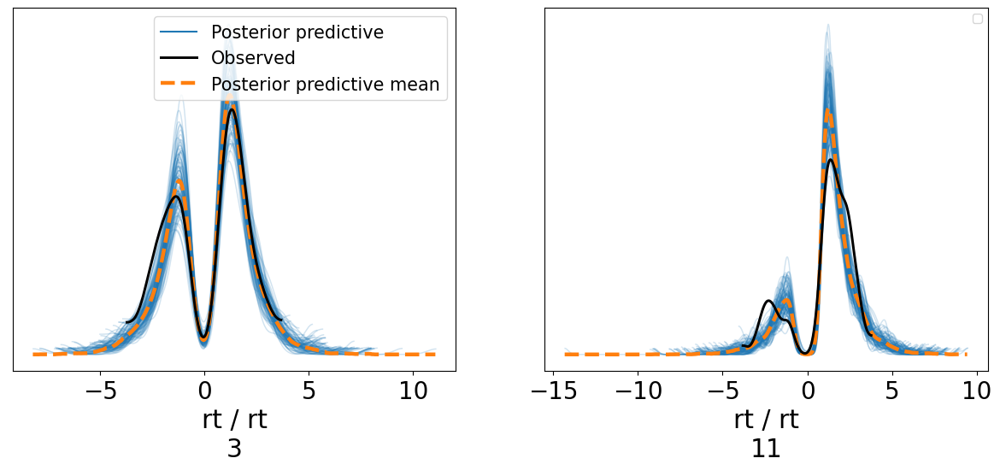

In [ ]:
# reset coordinates
m0_infdata = m0_infdata.assign_coords(
  obs_id=m0_infdata.observed_data.coords['subj_idx'].values, 
  groups="observed_vars")

# plot ppc for subj_idx (obs_id) is 0,1,2 and 3
axes = az.plot_ppc(
    m0_infdata, 
    var_names= 'rt', 
    coords={'obs_id': [3,11]}, 
    num_pp_samples=100,
    random_seed = 2023, 
    flatten=[], 
    # legend=False,
    textsize=20, 
    alpha = 0.2
)

In [ ]:
axes.ravel()[0].figure.savefig("fig7a1.pdf")

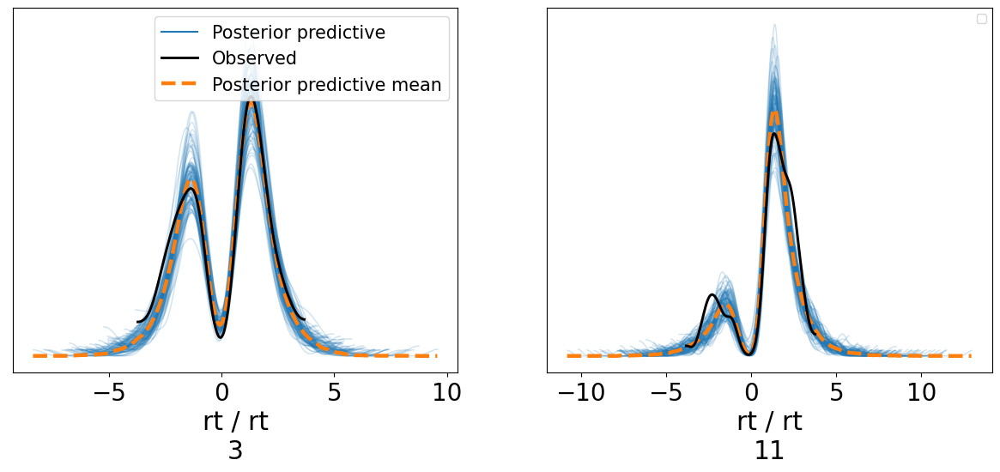

In [ ]:
# reset coordinates
m4_infdata = m4_infdata.assign_coords(
  obs_id=m4_infdata.observed_data.coords['subj_idx'].values, 
  groups="observed_vars")

# plot ppc for subj_idx (obs_id) is 0,1,2 and 3
axes = az.plot_ppc(
    m4_infdata, 
    var_names= 'rt', 
    coords={'obs_id': [3, 11]}, 
    num_pp_samples=100, 
    random_seed = 2023, 
    flatten=[], 
    # legend=False,
    textsize=20, 
    alpha = 0.2
)

In [ ]:
axes.ravel()[0].figure.savefig("fig7a2.pdf")

It is found that model 4 generate more similar predictions to observed data, especially for subject 11. 

Then, let us plot ppc on different conditions. 

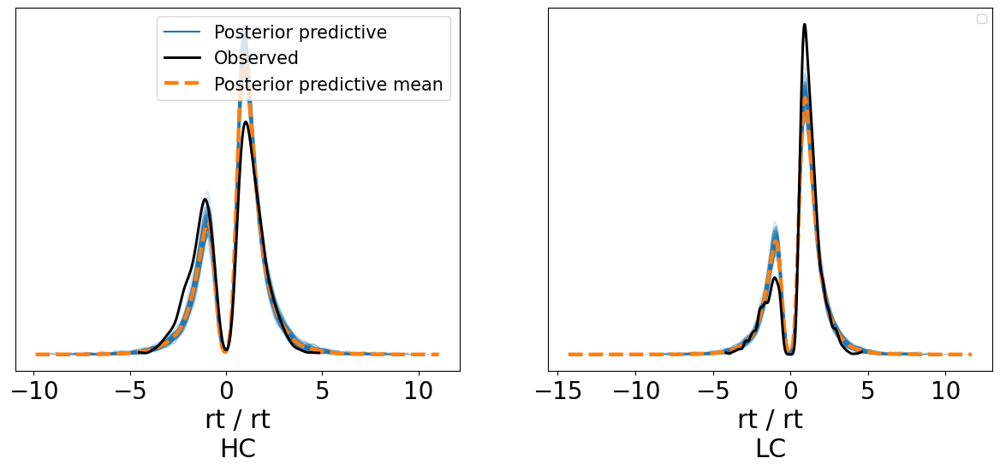

In [ ]:
# reset coordinates
m0_infdata = m0_infdata.assign_coords(
  obs_id=m0_infdata.observed_data.variables['conf'].values, 
  groups="observed_vars")


# plot ppc by conditions
axes = az.plot_ppc(
    m0_infdata, 
    var_names= 'rt', 
    coords={'obs_id': ["LC", "HC"]}, 
    num_pp_samples=100, 
    random_seed = 2023, 
    flatten=[], 
    # legend=False,
    textsize=20, 
    alpha = 0.2
)

In [ ]:
axes.ravel()[0].figure.savefig("fig7b1.pdf")

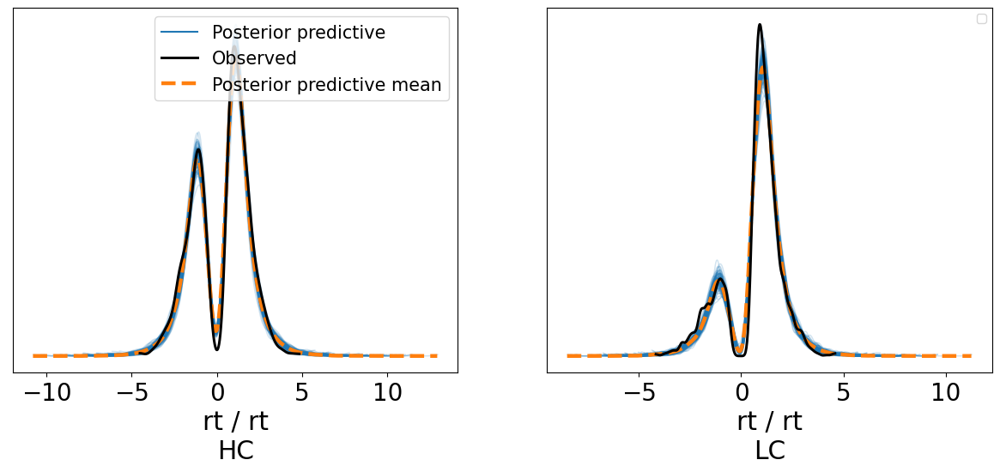

In [ ]:
# reset coordinates
m4_infdata = m4_infdata.assign_coords(
  obs_id=m4_infdata.observed_data.variables['conf'].values, 
  groups="observed_vars")


# plot ppc by conditions
axes = az.plot_ppc(
    m4_infdata, 
    var_names= 'rt', 
    coords={'obs_id': ["LC", "HC"]}, 
    num_pp_samples=100, 
    random_seed = 2023, 
    flatten=[], 
    # legend=False,
    textsize=20, 
    alpha = 0.2
)

In [ ]:
axes.ravel()[0].figure.savefig("fig7b2.pdf")

Model 4 get better predictions for both conflict condition (LC vs. HC), given that model 0 did not consider the impact from conflict condition. 

## Statistical Inference

Here we onlyu examplified how to us ROPE + HDI method. 

- Assume that we are interested in the effect of conflit level on drift rate `v` and we used [-0.2, 0.2] as the ROPE. 
- Then we can used visualize the ROPE and HDI with `az.plot_posterior()`.

(-0.9, 0.3)

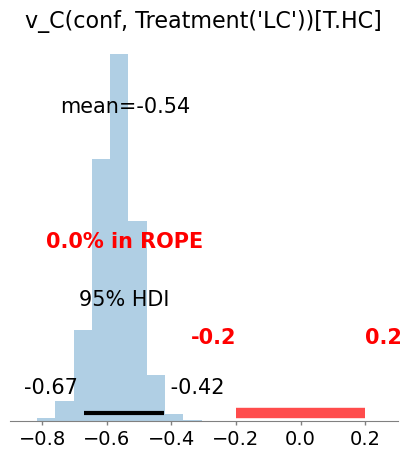

In [ ]:
# using regex to select var_names that start with "a_theta" and do not contain either "subj" or "std"
axes = az.plot_posterior(
    m4_infdata,
    var_names=("v_C(conf, Treatment('LC'))[T.HC]"),
    kind = 'hist',
    hdi_prob = 0.95,
    rope = [-0.2, 0.2], # assume this is our ROPE
    textsize=14, 
    rope_color = 'r',
    figsize = (5,5)
)
axes.set_xlim(-0.9,0.3)

In [ ]:
axes.figure.savefig("fig8a.pdf")

It is easy to find that the drift rate in HC is lower than it in LC. 

Then we plot the posteriors distribution of drift rates in both condition to reaffirm this results. 

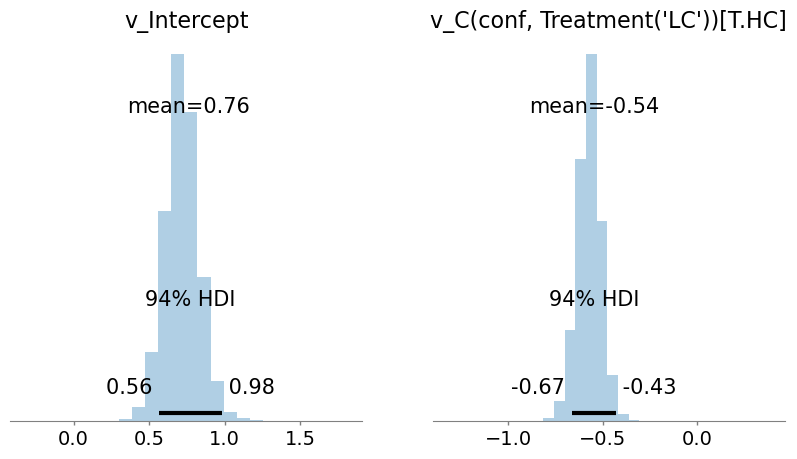

In [ ]:
# plot posterior histgram by conditions, 
# v_Intercept represent v in LC 
# and v_C(conf, Treatment('LC'))[T.HC] represent v in HC. 
axes = az.plot_posterior(
    m4_infdata, 
    var_names=("^v(?!.*(subj|std))"), 
    filter_vars='regex', 
    kind='hist',
    figsize = (10,5)
)

In [ ]:
m4_infdata.posterior["v_HC"] = (
    ("chain", "draw"),
    m4_infdata.posterior["v_Intercept"].values + \
    m4_infdata.posterior["v_C(conf, Treatment('LC'))[T.HC]"].values)
m4_infdata.posterior["v_LC"] = (
    ("chain", "draw"),
    m4_infdata.posterior["v_Intercept"].values)

Compare posterior using plot_forest. See [`az.plot_forest`](https://python.arviz.org/en/latest/api/generated/arviz.plot_forest.html#arviz.plot_forest) for more.

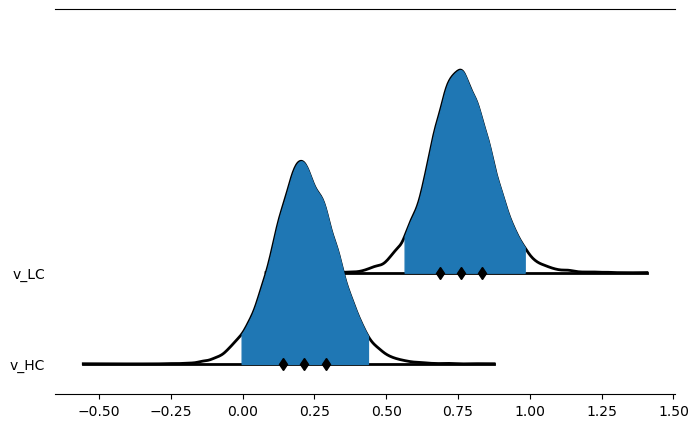

In [ ]:
 # plot posterior forest distriution by conditions
axes = az.plot_forest(
    m4_infdata,
    kind='ridgeplot',
    var_names=("v_LC", "v_HC"), 
    linewidth=2,
    ridgeplot_overlap=3,
    ridgeplot_truncate=False,
    ridgeplot_quantiles=[.25, .5, .75],
    combined=True,
    figsize=(8, 5)
 )

Similarly, violin plot can also be used:

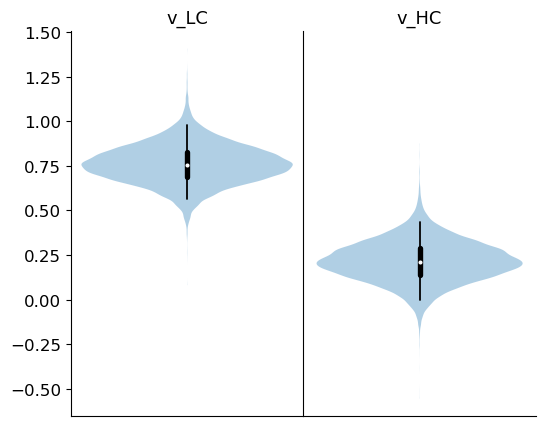

In [ ]:
import seaborn as sns
# plot posterior violin plot by conditions
axes = az.plot_violin(
    m4_infdata, 
    var_names=("v_LC", "v_HC"), 
    figsize=(6, 5),
    textsize=12
)

sns.despine()

In [ ]:
axes.ravel()[0].figure.savefig("fig8b.pdf")